<a href="https://colab.research.google.com/github/MarcosSilvares/data_Preparation/blob/main/Preparando_um_dataset_para_modelagem_de_dados.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Configurações

## Bibliotecas

In [ ]:
!pip install pandas-profiling==3.6.6

In [ ]:
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.preprocessing import scale, minmax_scale, power_transform

## Carregando Dados

In [ ]:
# Carregando os dados e vendo as 5 primeiras linhas

df = pd.read_csv('/content/data.csv', encoding='latin-1')
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom


# Análise Exploratória

In [ ]:
# Usando o "ProfileReport" para ter um parâmetro geral sobre a base de dados.

ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Com isso é possivel ter um bom parâmetro sobre a base, com informações como Número de Variáveis, Células faltantes em número e em porcentagem, Linhas Duplicadas em número e em porcentagem. Também é possivel ver os tipos das variáveis e a distribuição dos dados.

In [ ]:
# Verificando primeiramente a quantidade de valores nulos no dataset.

df.isna().sum()

InvoiceNo           0
StockCode           0
Description      1454
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     135080
Country             0
dtype: int64

É possivel ver 299 Valores Nulos na coluna "Description", 34935 Valores Nulos na coluna "CustomerID" e 1 Valor Nulo na coluna "Country"

In [ ]:
# Removendo as linhas que os preços unitários e quantidade de produtos são iguais ou inferiores a 0.

df_drop = df.query('Quantity > 0 and UnitPrice > 0').reset_index(drop=True)
df_drop.isnull().sum()

InvoiceNo           0
StockCode           0
Description         0
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     132220
Country             0
dtype: int64

In [ ]:
# Removendo as linhas nulas do CustomerID.

df_drop = df_drop[~df_drop['CustomerID'].isnull()].reset_index(drop=True)
df_drop.isnull().sum()

InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
CustomerID     0
Country        0
dtype: int64

Numero de Nulos Zerados.

In [ ]:
# Verificando se existem valores duplicados no dataset.

df = df_drop.copy()
df.duplicated().sum()

5192

In [ ]:
# Dropando as Linhas Duplicadas

df.drop_duplicates(inplace=True)


In [ ]:
# Verificando se existem valores duplicados no dataset.

df.duplicated().sum()

0

In [ ]:
df.isna().sum()

InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
CustomerID     0
Country        0
dtype: int64

Valores duplicados totalmente removidos.

In [ ]:
# Conferindo os Tipos de Dados

df.dtypes

InvoiceNo       object
StockCode       object
Description     object
Quantity         int64
InvoiceDate     object
UnitPrice      float64
CustomerID     float64
Country         object
dtype: object

In [ ]:
# Corrigindo o tipos das colunas InvoiceDate(para datetime64(ns)) e CustomerID(para int64)

# InvoiceDate
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'], format='%m/%d/%Y %H:%M').dt.date
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'], format='%Y-%m-%d')
df['InvoiceDate'].apply(type).unique()

# CustomerID
df['CustomerID'] = df['CustomerID'].astype(int)
df['CustomerID'].apply(type).unique()

# Observando os tipos de dados

df.dtypes

InvoiceNo              object
StockCode              object
Description            object
Quantity                int64
InvoiceDate    datetime64[ns]
UnitPrice             float64
CustomerID              int64
Country                object
TotalPrice            float64
dtype: object

In [ ]:
# Observando outliers

px.box(df, y=['Quantity', 'UnitPrice'])

In [ ]:
# Removendo os outliers de acordo com as instruções da empresa.

df = df.loc[(df['Quantity'] <= 10000) & (df['UnitPrice'] <= 5000)]

A empresa pede para remover os outliers extremos em que a quantidade do item na compra é superior a 10.000, e o preço unitário é maior que 5.000.


In [ ]:
# Observando se existem outliers após remove-los de acordo com as métricas da empresa.

px.box(df, y=['Quantity', 'UnitPrice'])

In [ ]:
# Criando a coluna de preço total da compra

df['TotalPrice'] = df['Quantity'] * df['UnitPrice']
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,TotalPrice
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01,2.55,17850,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01,3.39,17850,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01,2.75,17850,United Kingdom,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01,3.39,17850,United Kingdom,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01,3.39,17850,United Kingdom,20.34


In [ ]:
# Calculando a data da última compra

lastPurchase = df['InvoiceDate'].max()
print(f"Data da última compra: {lastPurchase}")

Data da última compra: 2011-12-09 00:00:00


In [ ]:
# Plotando alguns Gráficos começando pelo Top 10 países com maior valor em vendas

top10paises = df.groupby('Country')['TotalPrice'].sum().sort_values(ascending=False)
top10paises = top10paises.head(10)
top10paises.reset_index()

,Country,TotalPrice
0,United Kingdom,7031228.694
1,Netherlands,285446.340
2,EIRE,265262.460
3,Germany,228678.400
4,France,208934.310
5,Australia,138453.810
6,Spain,61558.560
7,Switzerland,56443.950
8,Belgium,41196.340
9,Sweden,38367.830


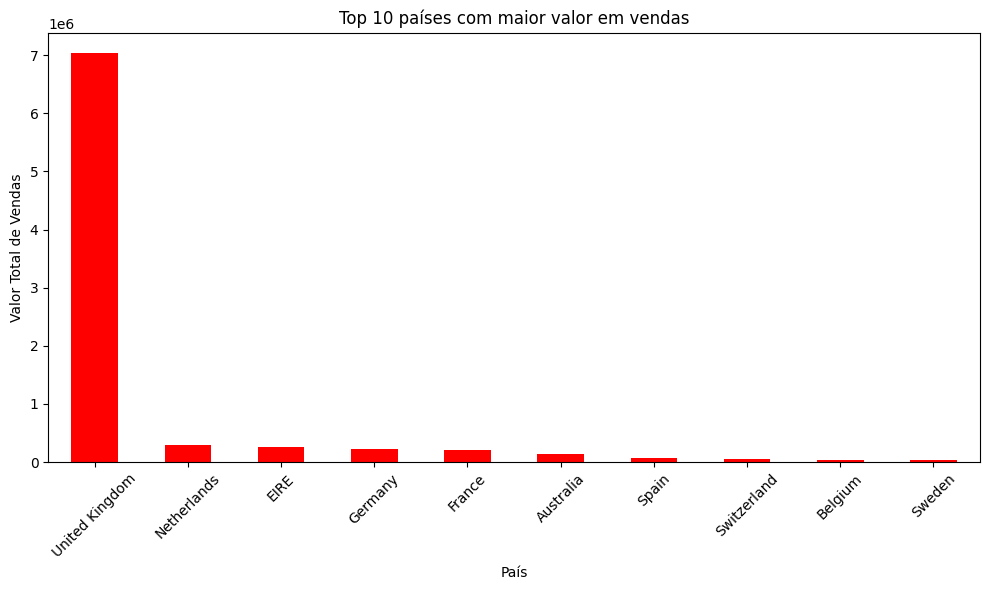

In [ ]:
plt.figure(figsize=(10, 6))
top10paises.plot(kind='bar', color='red')
plt.title('Top 10 países com maior valor em vendas')
plt.xlabel('País')
plt.ylabel('Valor Total de Vendas')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,TotalPrice
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01,2.55,17850,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01,3.39,17850,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01,2.75,17850,United Kingdom,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01,3.39,17850,United Kingdom,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01,3.39,17850,United Kingdom,20.34


In [ ]:
# Top 10 produtos mais vendidos

top10vendidos = df.groupby('Description')['Quantity'].sum()
top10vendidos = top10vendidos.sort_values(ascending=False).head(10)
top10vendidos.reset_index()

,Description,Quantity
0,WORLD WAR 2 GLIDERS ASSTD DESIGNS,54319
1,JUMBO BAG RED RETROSPOT,46078
2,WHITE HANGING HEART T-LIGHT HOLDER,36706
3,ASSORTED COLOUR BIRD ORNAMENT,35263
4,PACK OF 72 RETROSPOT CAKE CASES,33670
5,POPCORN HOLDER,30919
6,RABBIT NIGHT LIGHT,27153
7,MINI PAINT SET VINTAGE,26076
8,PACK OF 12 LONDON TISSUES,25329
9,PACK OF 60 PINK PAISLEY CAKE CASES,24230


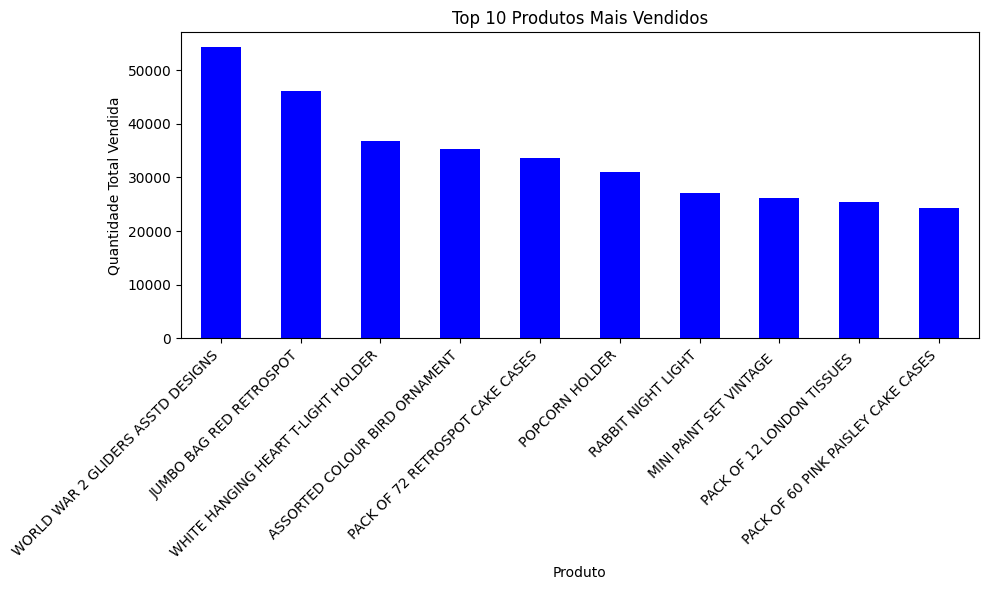

In [ ]:
# Plotando...

plt.figure(figsize=(10, 6))
top10vendidos.plot(kind='bar', color='blue')
plt.title('Top 10 Produtos Mais Vendidos')
plt.xlabel('Produto')
plt.ylabel('Quantidade Total Vendida')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [ ]:
# Valor de venda total por mês

# Extrair o ano e mês para uma nova coluna
df['YearMonth'] = df['InvoiceDate'].dt.to_period('M')

# Calcular o valor total de vendas por mês
vendas_mes = df.groupby('YearMonth')['TotalPrice'].sum()
vendas_mes.to_frame()

,TotalPrice
YearMonth,
2010-12,570422.730
2011-01,490917.710
2011-02,446084.920
2011-03,594081.760
2011-04,468374.331
2011-05,669212.400
2011-06,660046.050
2011-07,598962.901
2011-08,644051.040


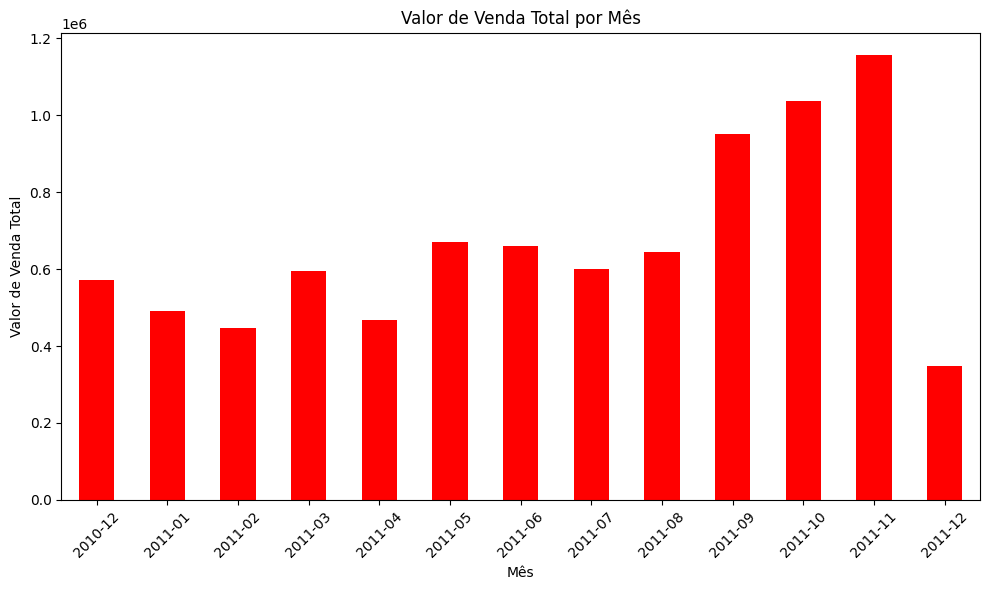

In [ ]:
# Plotando...

plt.figure(figsize=(10, 6))
vendas_mes.plot(kind='bar', color='red')
plt.xlabel('Mês')
plt.ylabel('Valor de Venda Total')
plt.title('Valor de Venda Total por Mês')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
# Valor de venda total por mês e por país (considerando apenas os top 10)

vendas_mes_pais = df.groupby(['YearMonth','Country'])['TotalPrice'].sum()
vendas_mes_pais = round(vendas_mes_pais.sort_values(ascending=False).head(10).to_frame(), 2)
vendas_mes_pais

,,TotalPrice
YearMonth,Country,
2011-11,United Kingdom,975251.39
2011-10,United Kingdom,821220.13
2011-09,United Kingdom,794806.69
2011-05,United Kingdom,542216.60
2011-06,United Kingdom,523775.59
2011-08,United Kingdom,497194.91
2010-12,United Kingdom,496477.34
2011-07,United Kingdom,484545.59
2011-03,United Kingdom,465784.19


<Figure size 1500x1000 with 0 Axes>

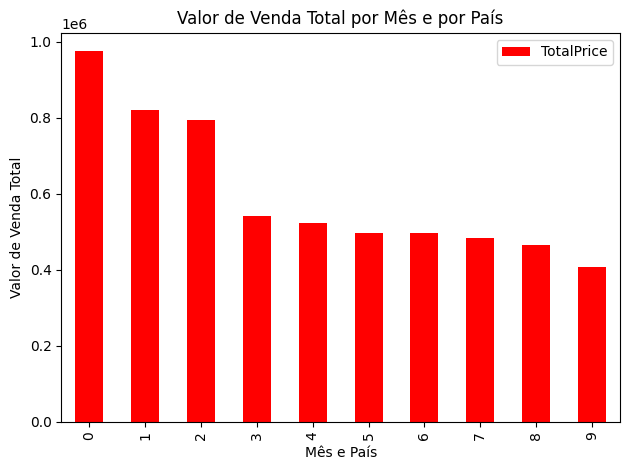

In [ ]:
# Plotando...

plt.figure(figsize=(15, 10))
vendas_mes_pais.plot(kind='bar', color='red')
plt.xlabel('Mês e País')
plt.ylabel('Valor de Venda Total')
plt.title('Valor de Venda Total por Mês e por País')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

# RFM

In [ ]:
# Calculando a Recência

recencia = (lastPurchase - df.groupby('CustomerID')['InvoiceDate'].max()).dt.days

In [ ]:
# Calculando a Frequência

frequencia = df.groupby('CustomerID')['InvoiceNo'].nunique()

In [ ]:
# Calculando o valor monetário

monetario = df.groupby('CustomerID')['TotalPrice'].sum()

In [ ]:
# Criando um DataFrame

rfm_df = pd.DataFrame({
    'Recency': recencia,
    'Frequency': frequencia,
    'Monetary': monetario
})

rfm_df.head()

,Recency,Frequency,Monetary
CustomerID,,,
12347,2,7,4310.00
12348,75,4,1797.24
12349,18,1,1757.55
12350,310,1,334.40
12352,36,8,2506.04
